In [1]:
import pandas as pd
import numpy as np
from sklearn.decomposition import NMF
from gpzoo.utilities import regularized_nmf, dims_autocorr
import matplotlib.pyplot as plt

/gladstone/engelhardt/home/lchumpitaz/gitclones/GPzoo/gpzoo/utilities.py:2: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


In [2]:
file_dir = '/gladstone/engelhardt/home/lchumpitaz/datasets/merfish/Moffitt_and_Bambah-Mukku_et_al_merfish_all_cells.csv'

In [3]:
df = pd.read_csv(file_dir)

In [4]:
df

,Cell_ID,Animal_ID,Animal_sex,Behavior,Bregma,Centroid_X,Centroid_Y,Cell_class,Neuron_cluster_ID,Ace2,...,Penk,Scg2,Sln,Sst,Tac1,Tac2,Th,Trh,Ucn3,Vgf
0,6749ccb4-2ed1-4029-968f-820a287f43c8,1,Female,Naive,0.26,-3211.562145,2608.541476,Astrocyte,NaN,0.0,...,0.133016,0.000000,0.865263,0.002977,0.054826,0.008934,0.000000,0.000000,0.000000,0.000000
1,6cac74bd-4ea7-4701-8701-42563cc65eb8,1,Female,Naive,0.26,-3207.923151,2621.795437,Inhibitory,I-5,0.0,...,0.000000,0.000000,0.277939,0.868702,0.580957,0.010079,0.000000,0.000000,0.000000,0.000000
2,9f29bd57-16a5-4b26-b9f5-37598809da9e,1,Female,Naive,0.26,-3209.578004,2633.153494,Inhibitory,I-6,0.0,...,0.213939,0.000000,0.377907,0.049332,0.084898,0.008951,0.000000,0.000000,0.000000,0.000000
3,d7eb4e0b-276e-47e3-a55c-0b033180a2fe,1,Female,Naive,0.26,-3203.853515,2756.045983,Inhibitory,I-5,0.0,...,0.050882,0.089038,0.000000,0.000000,0.001530,0.031364,0.000000,0.000000,0.000000,0.001138
4,54434f3a-eba9-4aec-af35-c9d317ffa1d5,1,Female,Naive,0.26,-3202.682705,2608.803635,Inhibitory,I-9,0.0,...,1.250661,0.159618,0.211159,0.000000,0.087730,0.000000,0.000000,0.000000,0.000000,0.029419
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1027843,eaaf93ba-75b1-40cd-af08-a4d803511354,30,Male,Mating,0.11,2732.438894,-2322.578167,Ambiguous,NaN,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.040998,0.000000,0.000000,0.024618,0.000000
1027844,bb9caf59-d960-452e-a9fd-9238ce5e44ca,30,Male,Mating,0.11,2732.665807,-2120.226450,Ambiguous,NaN,0.0,...,0.000000,0.852081,0.000000,0.695548,0.000000,0.024392,0.475944,0.000000,0.000000,0.000000
1027845,2f45d61d-3a80-470b-8cb8-251a2c8d2e59,30,Male,Mating,0.11,2826.247461,-2308.947366,Ambiguous,NaN,0.0,...,0.058011,0.000000,0.000000,0.000000,0.000000,0.061898,0.000000,0.000000,0.000000,0.000000
1027846,180ae0ff-9817-48b9-8d34-b374bda6e316,30,Male,Mating,0.11,2900.963778,-2174.600160,Inhibitory,I-2,0.0,...,0.000000,0.326172,0.000000,0.000000,0.000000,0.063518,0.000000,0.000000,0.000000,0.000000


In [5]:
def plot_factors(factors, X, moran_idx=None, ax=None, size=7, alpha=0.8, s=0.1, names=None):

    max_val = np.percentile(factors, 99)
    min_val = np.percentile(factors, 1)

    
    if moran_idx is not None:
        factors = factors[moran_idx]
        if names is not None:
            names = names[moran_idx]

    L = len(factors)

    if ax is None:
        fig, ax = plt.subplots(2, 6, figsize=(size*6, size*2), tight_layout=True)
        
    for i in range(L):
        
        
        curr_ax = ax[i//6, i%6]
        
        
        
        curr_ax.scatter(X[:, 0], X[:,1], c=factors[i], vmin=min_val, vmax=max_val, alpha=alpha, cmap='turbo', s=s)

        curr_ax.invert_yaxis()
        if names is not None:
            curr_ax.set_title(names[i], x=0.03, y=.88, fontsize="small", c="white",
                     ha="left", va="top")
            
        curr_ax.set_xticks([])
        curr_ax.set_yticks([])
        curr_ax.set_facecolor('xkcd:gray')

In [6]:
for col in df.columns.to_list():
    print(col)

Cell_ID
Animal_ID
Animal_sex
Behavior
Bregma
Centroid_X
Centroid_Y
Cell_class
Neuron_cluster_ID
Ace2
Adora2a
Aldh1l1
Amigo2
Ano3
Aqp4
Ar
Arhgap36
Avpr1a
Avpr2
Baiap2
Bdnf
Blank_1
Blank_2
Blank_3
Blank_4
Blank_5
Bmp7
Brs3
Calcr
Cbln1
Cbln2
Cckar
Cckbr
Ccnd2
Cd24a
Cdkn1a
Cenpe
Chat
Coch
Col25a1
Cplx3
Cpne5
Creb3l1
Crhbp
Crhr1
Crhr2
Cspg5
Cxcl14
Cyp19a1
Cyp26a1
Cyr61
Dgkk
Ebf3
Egr2
Ermn
Esr1
Etv1
Fbxw13
Fezf1
Fn1
Fst
Gabra1
Gabrg1
Gad1
Galr1
Galr2
Gbx2
Gda
Gem
Gjc3
Glra3
Gpr165
Greb1
Grpr
Htr2c
Igf1r
Igf2r
Irs4
Isl1
Kiss1r
Klf4
Krt90
Lepr
Lmod1
Lpar1
Man1a
Mc4r
Mki67
Mlc1
Myh11
Ndnf
Ndrg1
Necab1
Nos1
Npas1
Npy1r
Npy2r
Ntng1
Ntsr1
Nup62cl
Omp
Onecut2
Opalin
Oprd1
Oprk1
Oprl1
Oxtr
Pak3
Pcdh11x
Pdgfra
Pgr
Plin3
Pnoc
Pou3f2
Prlr
Ramp3
Rgs2
Rgs5
Rnd3
Rxfp1
Scgn
Selplg
Sema3c
Sema4d
Serpinb1b
Serpine1
Sgk1
Slc15a3
Slc17a6
Slc17a7
Slc17a8
Slc18a2
Slco1a4
Sox4
Sox6
Sox8
Sp9
Synpr
Syt2
Syt4
Sytl4
Tacr1
Tacr3
Tiparp
Tmem108
Traf4
Trhr
Ttn
Ttyh2
Adcyap1
Cartpt
Cck
Crh
Fos
Gal
Gnrh1
Mbp
Nnat
Nts
Oxt


In [7]:
X = np.stack((df.Centroid_X.values, df.Centroid_Y.values), axis=1)

In [8]:
Y = df.iloc[:, 9:].values.T

In [9]:
Y_mask = np.isnan(Y)

In [10]:
Y[Y_mask]=0

In [11]:
Y.shape

(161, 1027848)

In [12]:
nmf_model = NMF(n_components=24, max_iter=500, init='random', random_state=12, alpha_H=2e-1, alpha_W=1e-7)

In [13]:
nmf_model.fit(Y.T)

/gladstone/engelhardt/home/lchumpitaz/miniconda3/envs/gpzoo/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1710: ConvergenceWarning: Maximum number of iterations 500 reached. Increase it to improve convergence.
  warnings.warn(


NMF(alpha_H=0.2, alpha_W=1e-07, init='random', max_iter=500, n_components=24,
    random_state=12)

In [14]:
exp_factors = nmf_model.transform(Y.T)/5
factors = np.log(exp_factors + 1e-2)
loadings = nmf_model.components_.T*5

In [15]:
moran_idx, moranI = dims_autocorr(np.exp(factors), X)

here_andata


In [16]:
moranI

array([0.09883489, 0.07070152, 0.06454876, 0.0569178 , 0.0561123 ,
       0.05289163, 0.0470248 , 0.04559578, 0.04351919, 0.04275322,
       0.03907167, 0.03454798, 0.03294327, 0.03270757, 0.0317732 ,
       0.02782579, 0.02686035, 0.01890353, 0.01771177, 0.01610316,
       0.00952857, 0.00875558, 0.00747666, 0.00358427])

In [17]:
factors_ordered=factors[:, moran_idx]
loadings_ordered=loadings[:, moran_idx]

In [18]:
len(X[::10])

102785

In [19]:
df[df.Animal_ID==1].Bregma

0        0.26
1        0.26
2        0.26
3        0.26
4        0.26
         ... 
73650   -0.29
73651   -0.29
73652   -0.29
73653   -0.29
73654   -0.29
Name: Bregma, Length: 73655, dtype: float64

0.26


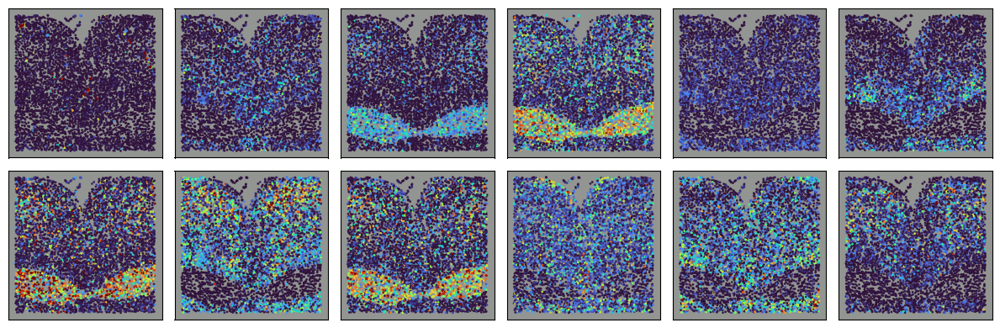

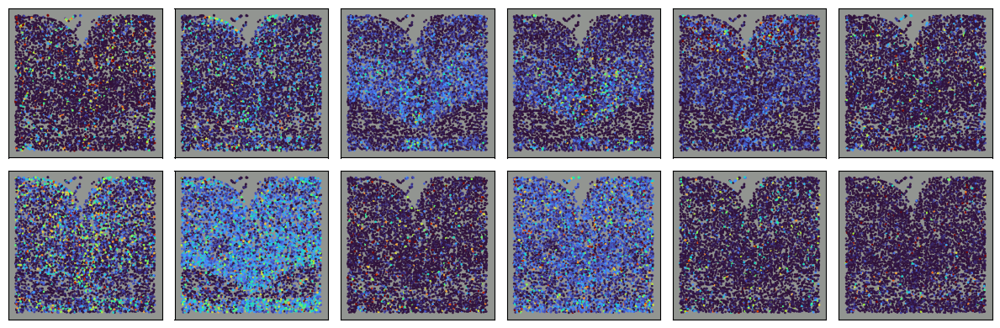

0.21


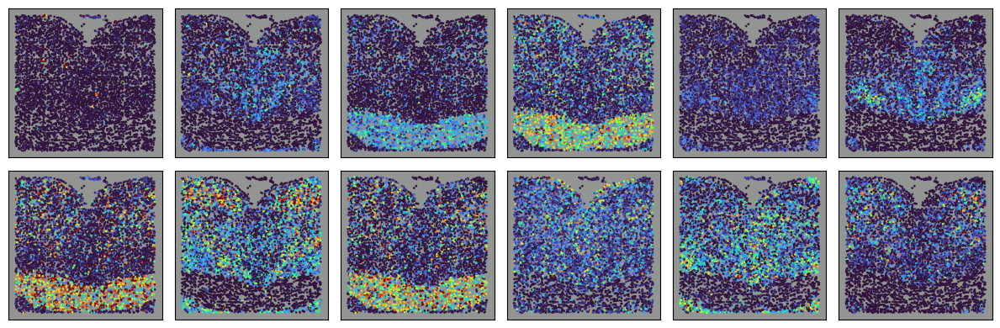

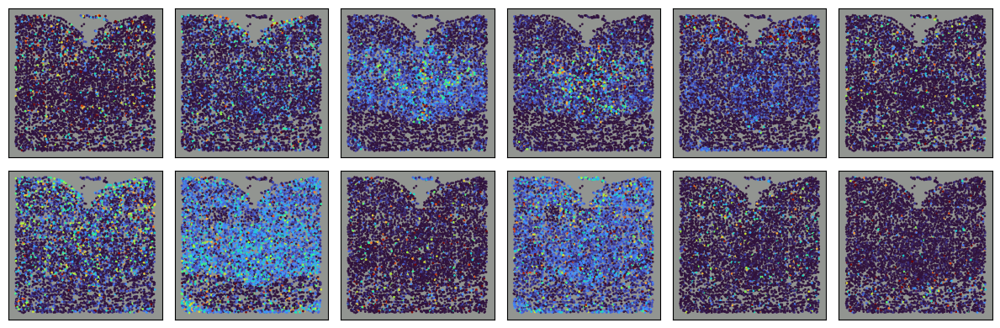

0.16


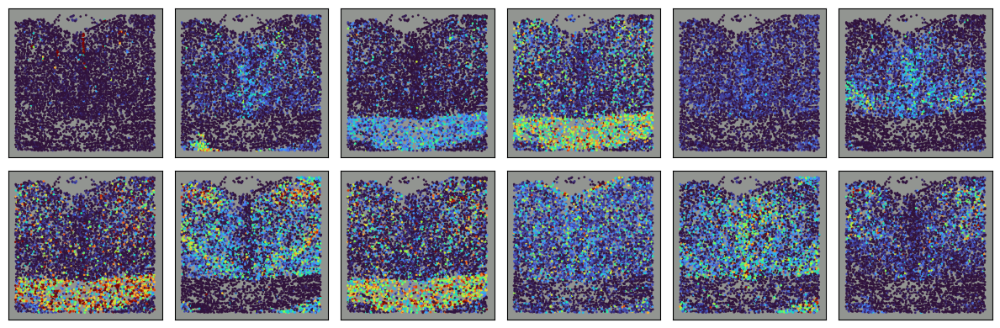

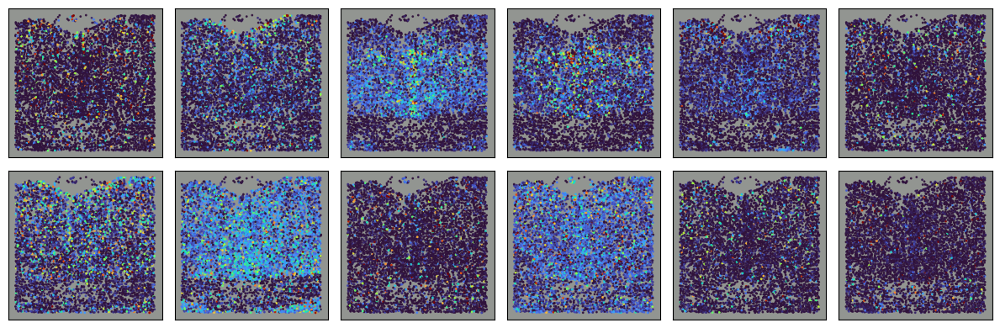

0.11


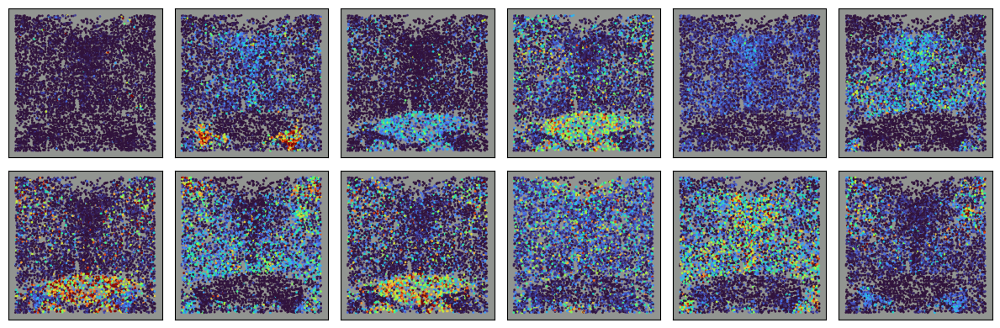

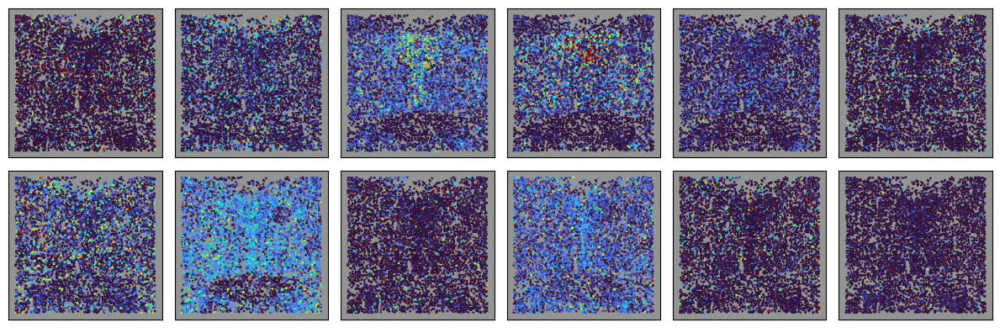

0.06


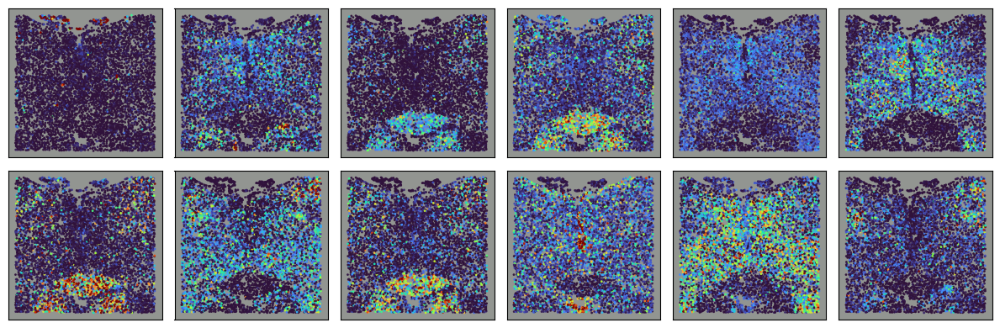

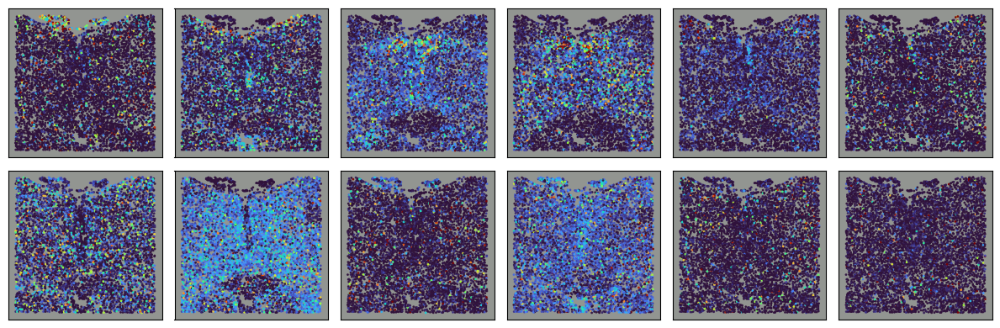

0.01


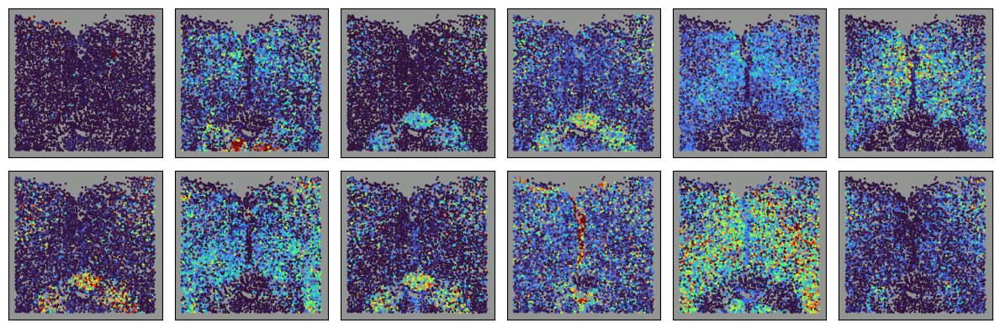

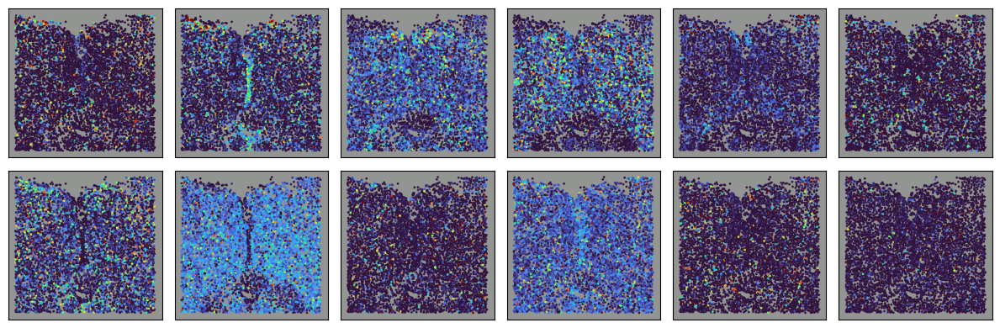

-0.04


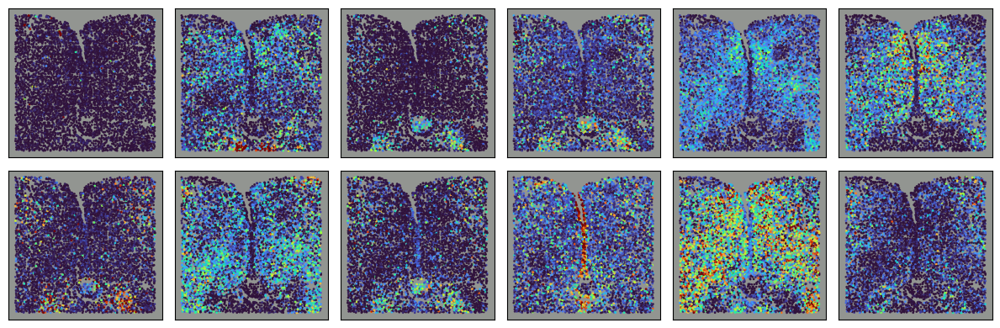

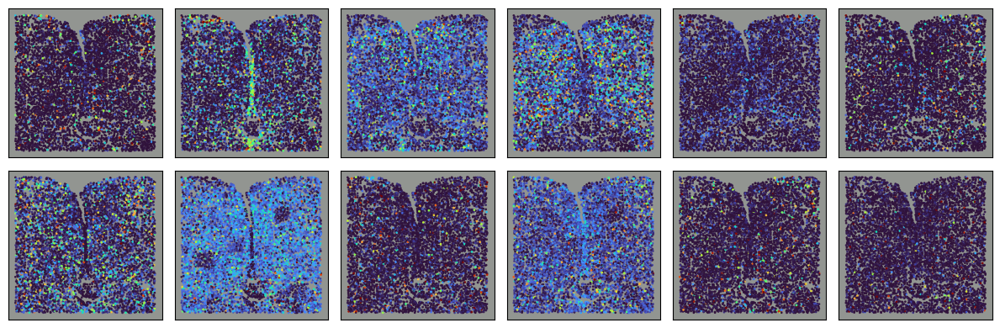

-0.09


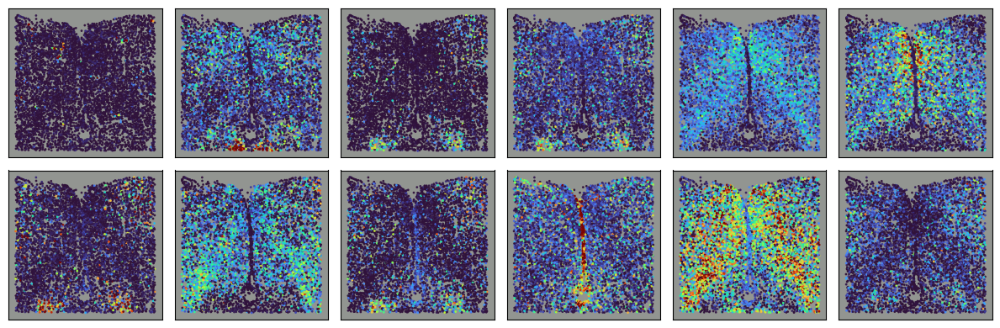

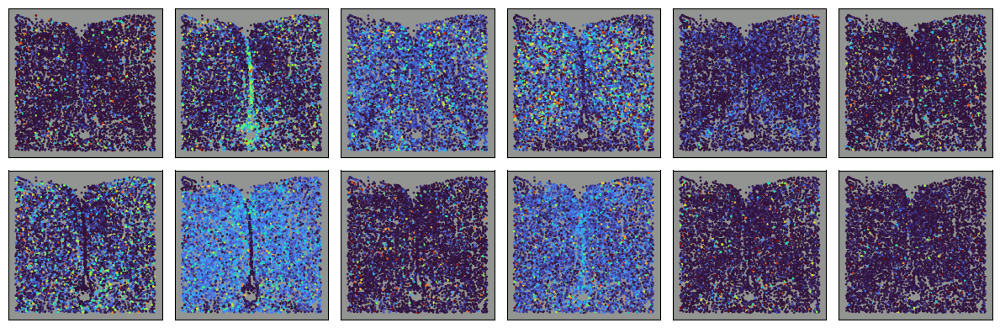

-0.14


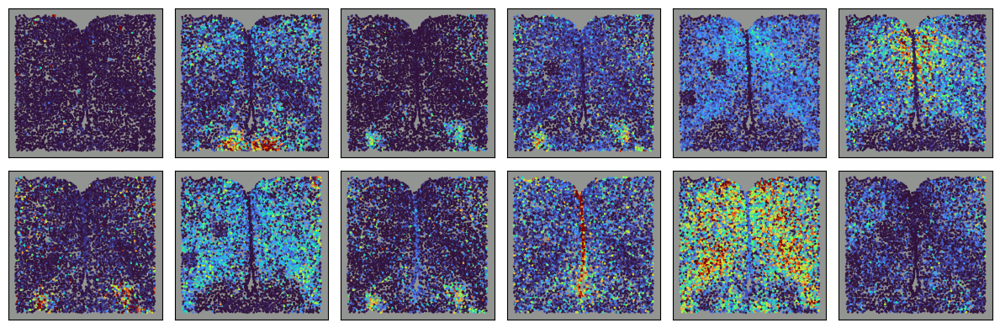

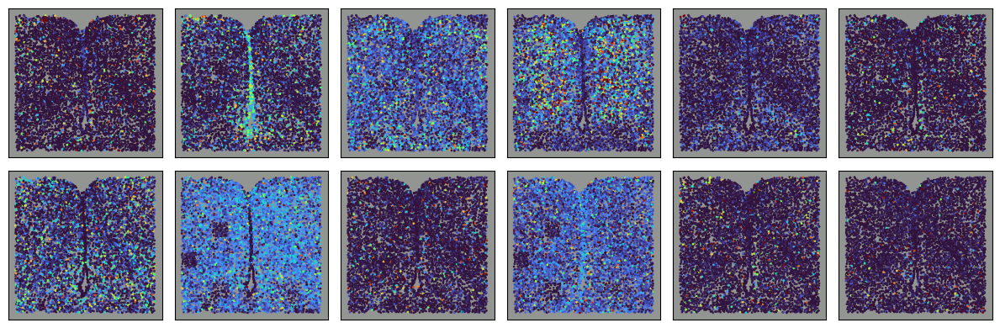

-0.19


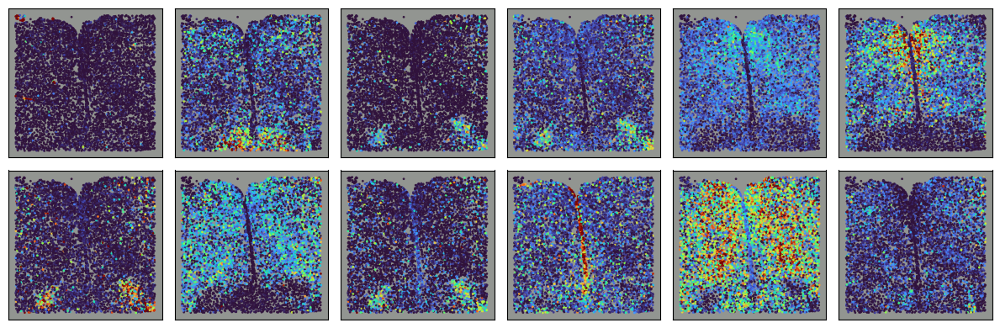

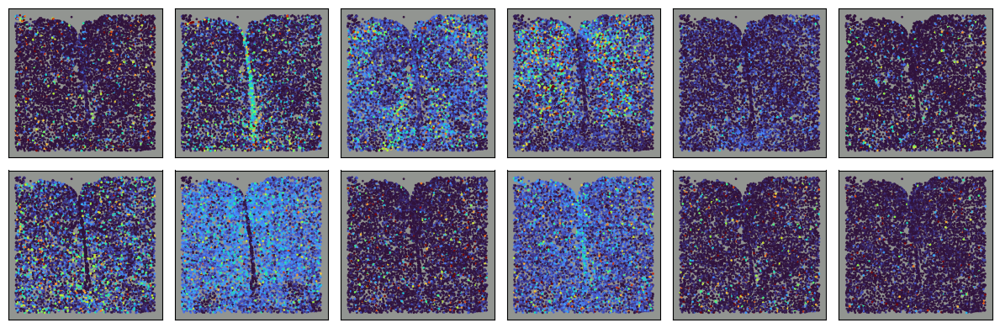

-0.24


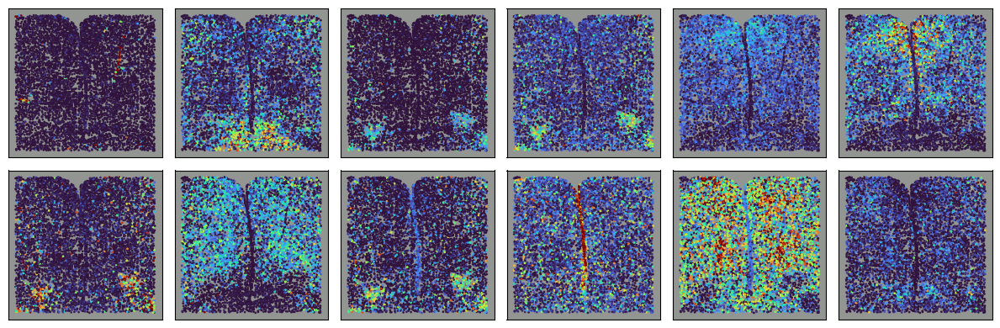

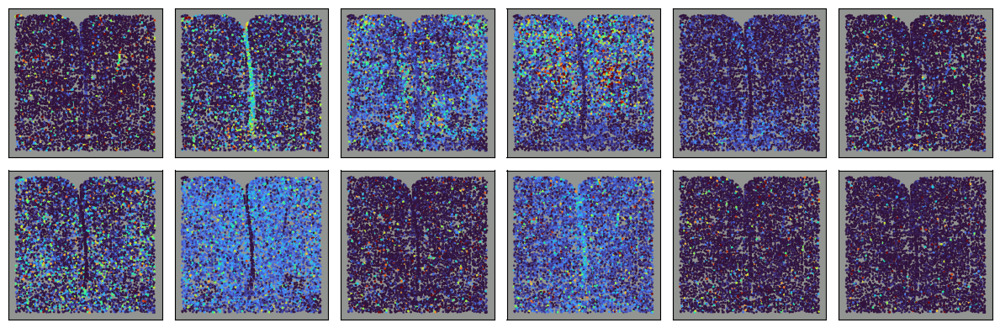

-0.29


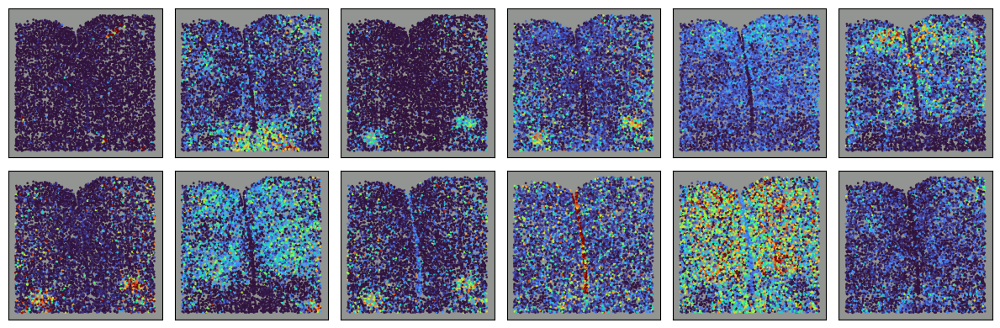

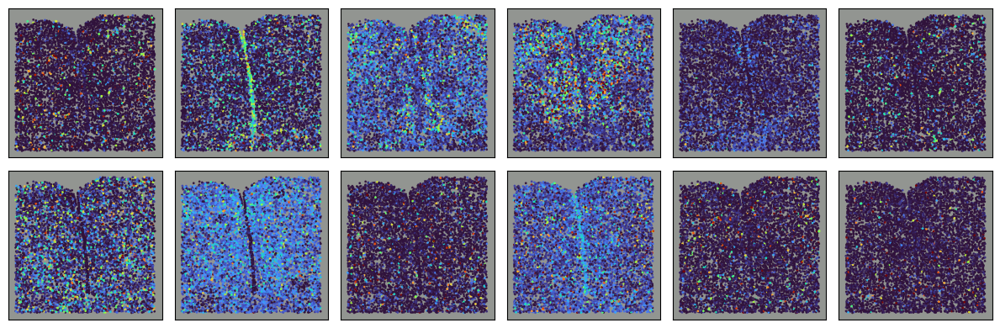

In [20]:
for i in range(1, 2):
    animal_mask = df.Animal_ID == i
    bregmas = df[df.Animal_ID==i].Bregma.unique()

    for bregma in bregmas:
        bregma_mask = df[df.Animal_ID==i].Bregma == bregma
        print(bregma)
        
        plot_factors(np.exp(factors_ordered[animal_mask][bregma_mask].T)[:12], X[animal_mask][bregma_mask], moran_idx=None, ax=None, size=2, s=1, alpha=0.9)
        plt.show()
        plot_factors(np.exp(factors_ordered[animal_mask][bregma_mask].T)[12:], X[animal_mask][bregma_mask], moran_idx=None, ax=None, size=2, s=1, alpha=0.9)
        plt.show()

In [21]:
bregmas

array([ 0.26,  0.21,  0.16,  0.11,  0.06,  0.01, -0.04, -0.09, -0.14,
       -0.19, -0.24, -0.29])